In [1]:
# import np
# %pip install tf_keras_vis tflite-support-nightly
# %pip install Keras-Preprocessing
# !pip install tf-keras-vis
# !pip install tensorflow-gpu

# Create your dataset

1) Choose which classes you would like to add.

2) Create a dataset with your own photos

3) Separate your dataset into train and test subsets.

In [2]:
import os
import pandas as pd
from glob import glob

def create_dataframe_from_directories(path):
    data = []

    for label_dir in os.listdir(path):
        if os.path.isfile(label_dir):
            continue

        label_path_path = os.path.join(path, label_dir)
        for file in os.listdir(label_path_path):
            data.append([os.path.join(label_path_path, file), label_dir])
        
    return pd.DataFrame(data, columns = ["path", "label"])

In [3]:
df = create_dataframe_from_directories("dataset")
#test_df = create_dataframe_from_directories("dataset_test")

In [4]:
LABEL_NAMES = pd.unique(df['label'])
LABEL_NAMES

array(['Ash', 'Beech', 'European Spindle Tree', 'Forsythia', 'Gean',
       'Hazel', 'Hornbeam', 'Horse Chestnut', 'Red Robin', 'Silver Birch',
       'Wayfaring Tree'], dtype=object)

**TODO**: Display some images of your dataset

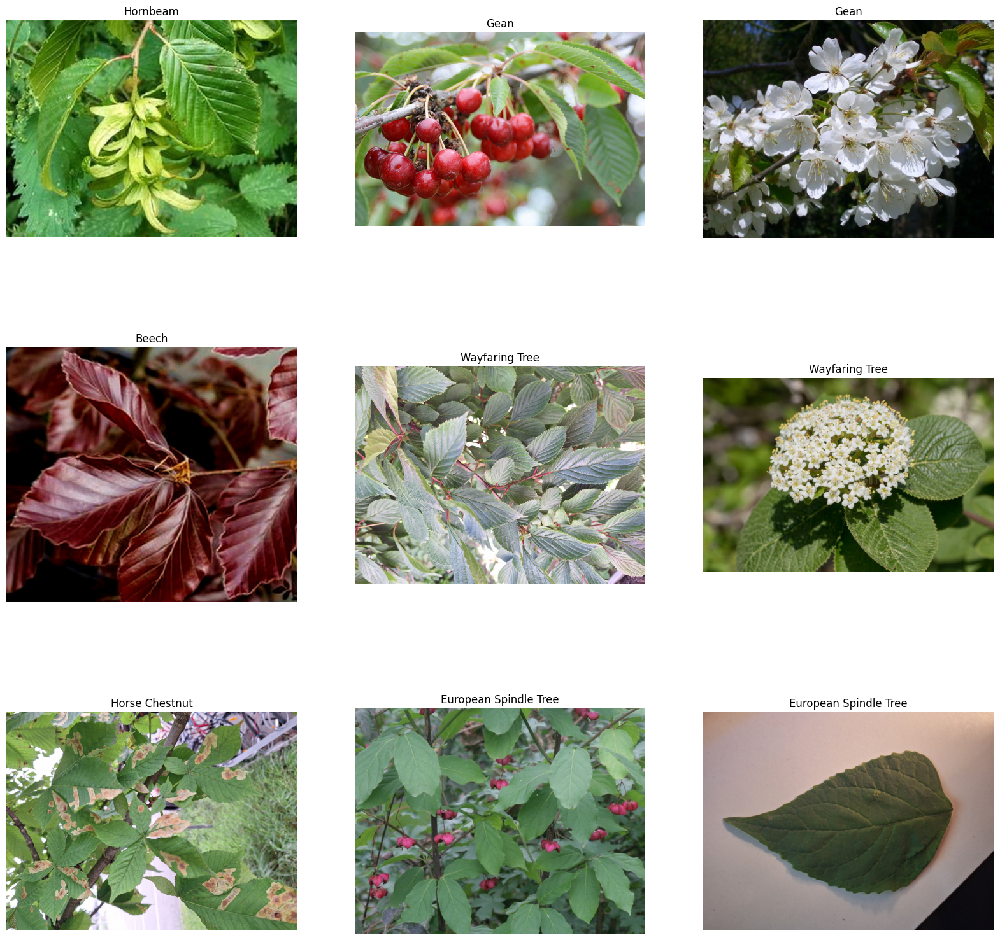

In [5]:
import matplotlib.pyplot as plt
import PIL
import PIL.Image

plt.figure(figsize=(20, 20))

i = 0
for _, rowdata in df.sample(frac=1).head(9).iterrows():
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(PIL.Image.open(rowdata.path))
    plt.title(rowdata.label)
    plt.axis("off")
    i += 1

# Explore your dataset

**TODO**: count the number of examples per classes and plot an histogram of it

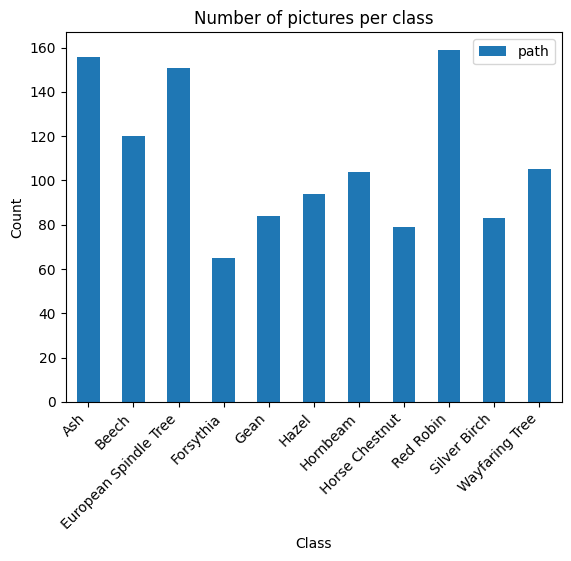

In [6]:
import matplotlib.pyplot as plt

# Count the number of examples per classes
count_per_class = df.groupby('label').count()

# Plot the histogram
count_per_class.plot(kind='bar')
plt.title('Number of pictures per class')
plt.xlabel('Class')
plt.ylabel('Count')

plt.xticks(rotation=45, ha='right')

plt.show()

# Preprocessing steps

In [7]:
from tensorflow.keras.layers import (
    Resizing, Rescaling,
)

from tensorflow.keras import Sequential
from tensorflow.keras import layers

IMG_HEIGHT = 224
IMG_WIDTH = 224

image_preprocesses = Sequential([
    Resizing(IMG_HEIGHT, IMG_WIDTH, crop_to_aspect_ratio=True),
    Rescaling(1. / 255)
])

image_augmentations = Sequential([
    # TODO: choose some image augmentations layers
    # see which keras layers you can use
    # The kind of layers you will want to use starts with "Random".
    # See the following page for more information on data augmentation :
    # https://www.tensorflow.org/tutorials/images/data_augmentation
    layers.RandomFlip("horizontal_and_vertical"),
    layers.RandomRotation(0.3),
    layers.RandomZoom(0.3),
    layers.RandomContrast(0.3),
    layers.RandomTranslation(height_factor=0.2, width_factor=0.2), # Add translation
])

def open_images(paths):
    return np.stack([
        open_image(path) for path in paths
    ])

def open_image(path):
    with PIL.Image.open(path).convert('RGB') as image:
        opened_img = image_preprocesses(np.asarray(image))

    return opened_img

def augment_images(images):
    return np.stack([
        image_augmentations(img) for img in images
    ])

**TODO**: plot examples of preprocessed and augmented images

# Split the dataset

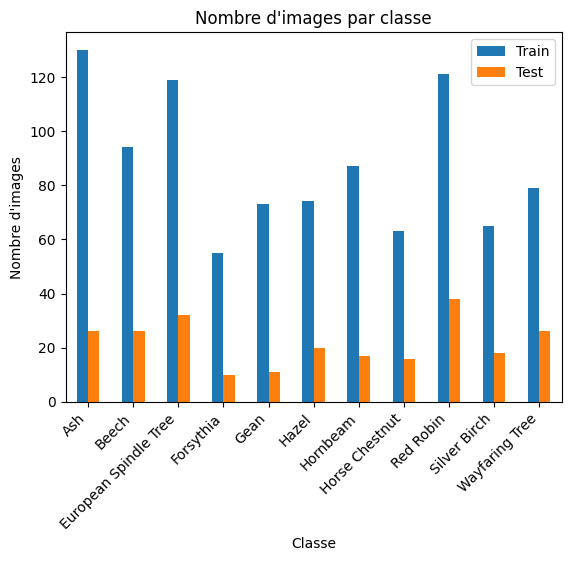

In [8]:
#Split the dataset into train and test
from sklearn.model_selection import train_test_split

train_df, test_df = train_test_split(df, test_size=0.2, random_state=1234)

train_df = train_df.reset_index(drop=True)
test_df = test_df.reset_index(drop=True)

def create_histogram(train, test):
    df1 = train.groupby('label').count()
    df2 = test.groupby('label').count()
    df = pd.merge(df1, df2, on='label')
    ax = df.plot.bar(title="Nombre d'images par classe",
                       xlabel='Classe',
                       ylabel="Nombre d'images")
    plt.xticks(rotation=45, ha='right')
    ax.legend(["Train", "Test"])
    plt.show()
    
create_histogram(train_df, test_df)

['dataset\\Red Robin\\20240615_005141.jpg', 'dataset\\Red Robin\\Image_9.jpg', 'dataset\\Ash\\Image_27.jpg', 'dataset\\European Spindle Tree\\Image_43.jpg', 'dataset\\Horse Chestnut\\Image_7.jpg', 'dataset\\Ash\\Image_108.jpg', 'dataset\\Beech\\Image_2.jpg', 'dataset\\Ash\\Image_122.jpg', 'dataset\\Forsythia\\20240615_005844.jpg']


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.121316].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.0682627].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.1338347].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.070703].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.0176787].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.0619227].


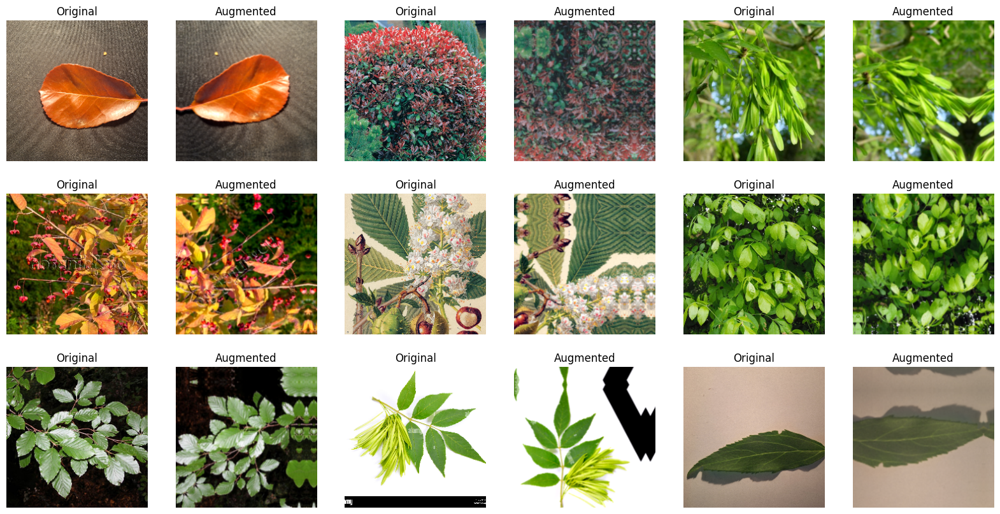

In [10]:
import matplotlib.pyplot as plt
import numpy as np

# Displaying some images of the train dataset
random_image_paths = train_df.sample(n=9)['path'].tolist()


print(random_image_paths)

fig, axs = plt.subplots(3, 6, figsize=(20, 10), gridspec_kw={'hspace': 0.2})
axs = axs.flatten()

for i in range(9): # Display 9 images
    # Load and preprocess the image
    image = open_image(random_image_paths[i])

    # Get the augmented image
    augmented_img = augment_images(np.expand_dims(image, axis=0))[0]

    # Plot the original image

    axs[2*i].imshow(image)
    axs[2*i].set_title(f"Original")
    axs[2*i].axis("off")

    # Plot the augmented image
    axs[2*i+1].imshow(augmented_img)
    axs[2*i+1].set_title(f"Augmented")
    axs[2*i+1].axis("off")

plt.show()

## Define model

In [11]:
from tensorflow.keras.applications import MobileNetV2
import tensorflow as tf
from tensorflow.keras.optimizers import RMSprop
from tensorflow.keras.losses import SparseCategoricalCrossentropy
from tensorflow.keras import Model
from tensorflow.keras.layers import (
    GlobalAveragePooling2D,
    Dense,
    Dropout,
    SpatialDropout2D,
    Attention,
    BatchNormalization,
)

def get_model():
    base_model = MobileNetV2(
        input_shape=(224, 224, 3),
        weights='imagenet',
        include_top=False
    )

    layers = base_model.output

    added_layers = [
        # important, we need global average pooling instead of flatten for class activation map later on 
        GlobalAveragePooling2D(),
        Dense(128, activation='relu', kernel_regularizer=tf.keras.regularizers.l2(0.001)),
        Dropout(0.5),
        BatchNormalization(),
        Dense(len(LABEL_NAMES), activation='softmax', kernel_regularizer=tf.keras.regularizers.l2(0.001))
    ]

    model = Model(inputs=base_model.input, outputs=Sequential(added_layers)(layers))

    # TODO: freeze layers
    for layer in base_model.layers:
        layer.trainable = False


    model.compile(
      optimizer = tf.keras.optimizers.Adam(learning_rate=0.001),
      loss = SparseCategoricalCrossentropy(),
      metrics = ['acc']
    )

    return model

In [12]:
get_model().summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv1 (Conv2D)                 (None, 112, 112, 32  864         ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 bn_Conv1 (BatchNormalization)  (None, 112, 112, 32  128         ['Conv1[0][0]']                  
                                )                                                             

# Model training

**TODO**: cross-validate your model, you can base yourself on the code from the first part of this practical work

**NOTE**: you shouldn't augment validations images. What we want to evaluate is the performances on "real" images, not on images that are augmented and change all the time

In [13]:
from sklearn.utils import class_weight
import numpy as np
import tensorflow as tf
from sklearn.model_selection import KFold
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split

# tf.keras.mixed_precision.set_global_policy('mixed_float16') # Mixed precision training
# tf.config.optimizer.set_jit(True) # Enable XLA

shuffled_dataset = train_df.sample(frac=1, random_state=1234).reset_index(drop=True)

dataset_paths = shuffled_dataset['path'].to_numpy()
dataset_labels = shuffled_dataset['label'].to_numpy()

total_train_paths, test_paths, total_train_labels, test_labels = train_test_split(
    dataset_paths, dataset_labels, test_size=0.2, random_state=1234
)

# We need to convert from string labels to integers
label_encoder = LabelEncoder()
label_encoder.fit(dataset_labels)
total_train_labels = label_encoder.transform(total_train_labels)
test_labels = label_encoder.transform(test_labels)

# Get the class distribution
class_distribution = train_df.groupby('label').size().to_dict()

# Set a target number of examples per class
target_examples_per_class = int(max(class_distribution.values()) / 5)

NB_EPOCHS = 30

train_losses = []
train_accuracies = []
val_losses = []
val_accuracies = []

for fold_num, (train_index, val_index) in enumerate(KFold(n_splits=5).split(total_train_paths, total_train_labels)):
    train_images = open_images(total_train_paths[train_index])
    train_labels = total_train_labels[train_index]

    # Augment all classes to reach the target number of examples
    augmented_train_images = []
    augmented_train_labels = []
    for img, label in zip(train_images, train_labels):
        class_name = label_encoder.inverse_transform([label])[0]
        num_current_examples = class_distribution[class_name]
        num_augmentations_needed = target_examples_per_class - num_current_examples

        # Apply class-specific augmentations
        augmented_imgs = [img]
        for _ in range(num_augmentations_needed):
            augmented_img = augment_images(np.expand_dims(img, axis=0))[0]
            augmented_imgs.append(augmented_img)

        augmented_train_images.extend(augmented_imgs)
        augmented_train_labels.extend([label] * len(augmented_imgs))

    augmented_train_images = np.stack(augmented_train_images)
    augmented_train_labels = np.array(augmented_train_labels)

    val_images = open_images(total_train_paths[val_index])
    val_labels = total_train_labels[val_index]

    model = get_model()  # We reinitialize the model

    history = model.fit(
        x=augmented_train_images,
        y=augmented_train_labels,
        batch_size=32,
        validation_data=[val_images, val_labels],
        epochs=NB_EPOCHS,
    )

    train_losses.append(history.history['loss'])
    val_losses.append(history.history['val_loss'])
    train_accuracies.append(history.history['acc'])
    val_accuracies.append(history.history['val_acc'])

Epoch 1/30
20/20 [==============================] - 4s 86ms/step - loss: 2.5500 - acc: 0.1971 - val_loss: 2.1197 - val_acc: 0.3052
Epoch 2/30
20/20 [==============================] - 1s 41ms/step - loss: 1.7705 - acc: 0.4544 - val_loss: 1.7954 - val_acc: 0.4675
Epoch 3/30
20/20 [==============================] - 1s 41ms/step - loss: 1.4533 - acc: 0.5831 - val_loss: 1.6141 - val_acc: 0.5584
Epoch 4/30
20/20 [==============================] - 1s 42ms/step - loss: 1.3167 - acc: 0.6482 - val_loss: 1.4612 - val_acc: 0.5909
Epoch 5/30
20/20 [==============================] - 1s 41ms/step - loss: 1.1711 - acc: 0.6938 - val_loss: 1.3860 - val_acc: 0.6883
Epoch 6/30
20/20 [==============================] - 1s 41ms/step - loss: 1.0126 - acc: 0.7476 - val_loss: 1.3070 - val_acc: 0.6753
Epoch 7/30
20/20 [==============================] - 1s 43ms/step - loss: 0.8836 - acc: 0.8176 - val_loss: 1.2874 - val_acc: 0.6688
Epoch 8/30
20/20 [==============================] - 1s 41ms/step - loss: 0.8014 - a

# Results

**TODO**: plot the results from your crossvalidation

In [14]:
def plot_kfold_mean_performance(ax, train_performances, val_performances, measure_name):
    train_mean = np.mean(train_performances, axis=0)
    val_mean = np.mean(val_performances, axis=0)
    train_sd = np.std(train_performances, axis=0)
    val_sd = np.std(val_performances, axis=0)

    ax.fill_between(np.arange(NB_EPOCHS), train_mean, train_mean+train_sd, facecolor='blue', alpha=0.5, label='Train')
    ax.fill_between(np.arange(NB_EPOCHS), train_mean, train_mean-train_sd, facecolor='blue', alpha=0.5)

    ax.fill_between(np.arange(NB_EPOCHS), val_mean, val_mean+val_sd, facecolor='orange', alpha=0.5, label='Val')
    ax.fill_between(np.arange(NB_EPOCHS), val_mean, val_mean-val_sd, facecolor='orange', alpha=0.5)

    ax.set_xticks(np.arange(NB_EPOCHS))

    ax.set_ylabel(measure_name)
    ax.set_xlabel('Number of epochs')
    #pl.title(str(K)+'-fold CV with '+str(n)+' hidden neurons')
    ax.legend()
    ax.grid()


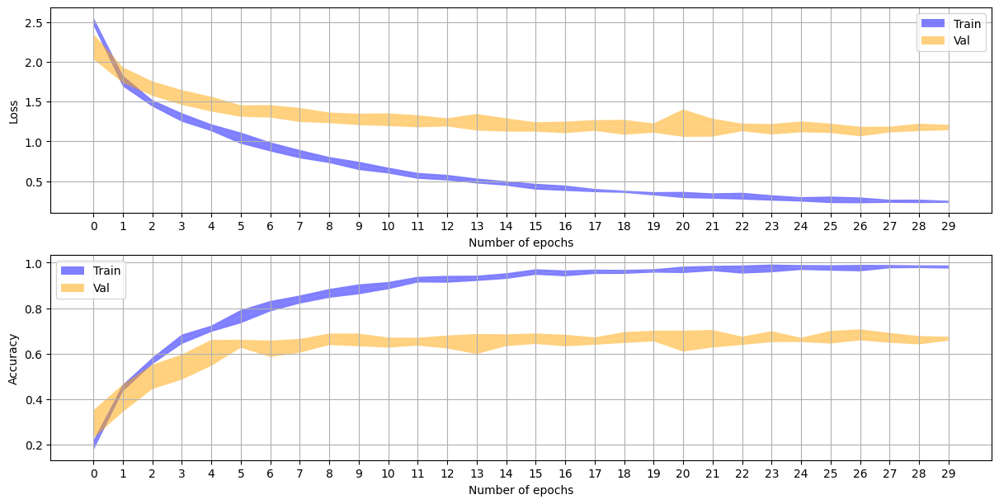

In [15]:
import matplotlib.pyplot as pl

fig, axs = plt.subplots(2, 1, constrained_layout=True, figsize=(12,6))

plot_kfold_mean_performance(axs[0], train_losses, val_losses, "Loss")
plot_kfold_mean_performance(axs[1], train_accuracies, val_accuracies, "Accuracy")

## Evaluate model on test set

In [16]:
# First retrain model on all the training data
train_images = open_images(total_train_paths)
train_labels = total_train_labels

model2 = get_model() # We reinitialize the model

history = model2.fit(
    x=train_images,
    y=train_labels,
    batch_size=32,
    epochs=NB_EPOCHS,
)

Epoch 1/30
24/24 [==============================] - 3s 38ms/step - loss: 2.4065 - acc: 0.2318
Epoch 2/30
24/24 [==============================] - 1s 35ms/step - loss: 1.6346 - acc: 0.5013
Epoch 3/30
24/24 [==============================] - 1s 35ms/step - loss: 1.3601 - acc: 0.6029
Epoch 4/30
24/24 [==============================] - 1s 35ms/step - loss: 1.2235 - acc: 0.6719
Epoch 5/30
24/24 [==============================] - 1s 35ms/step - loss: 1.0058 - acc: 0.7604
Epoch 6/30
24/24 [==============================] - 1s 35ms/step - loss: 0.9053 - acc: 0.7930
Epoch 7/30
24/24 [==============================] - 1s 35ms/step - loss: 0.7869 - acc: 0.8203
Epoch 8/30
24/24 [==============================] - 1s 35ms/step - loss: 0.6997 - acc: 0.8750
Epoch 9/30
24/24 [==============================] - 1s 35ms/step - loss: 0.6297 - acc: 0.8971
Epoch 10/30
24/24 [==============================] - 1s 35ms/step - loss: 0.5411 - acc: 0.9180
Epoch 11/30
24/24 [==============================] - 1s 35m

In [17]:
# Empty a bit the memory
import gc

del train_images
del train_labels
gc.collect()

61681

In [18]:
import sklearn.metrics as me
label_encoder = LabelEncoder()
label_encoder.fit(test_df['label'])


test_images = open_images(test_df['path'])  


test_labels = label_encoder.transform(test_df['label'])  

pred = model2.predict(test_images
    
)
pred = np.argmax(pred, axis=-1)

test_confusion_matrix = me.confusion_matrix(test_labels, pred, labels=np.arange(len(train_df['label'].unique())))

8/8 [==============================] - 1s 60ms/step


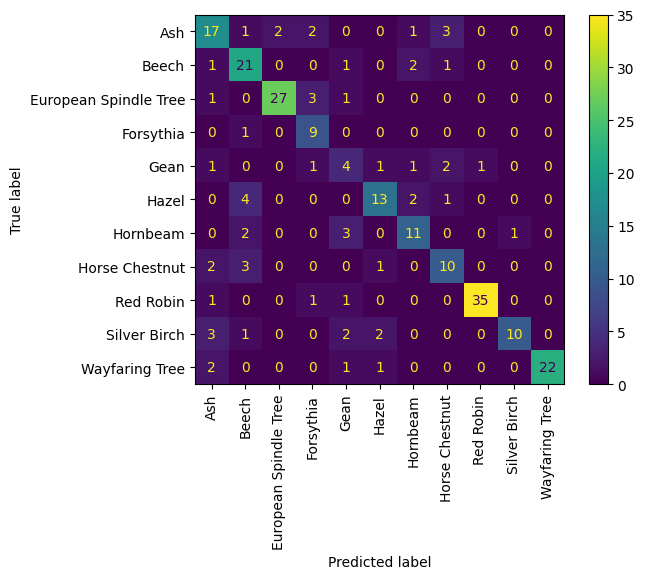

In [24]:
confusion_matrix_display = me.ConfusionMatrixDisplay(
    confusion_matrix=test_confusion_matrix,
    display_labels=LABEL_NAMES,
)


confusion_matrix_display.plot(xticks_rotation='vertical')
plt.show()

In [20]:
from sklearn.metrics import precision_recall_fscore_support
# Compute precision, recall, F-measure and support for each class
precision, recall, fscore, support = precision_recall_fscore_support(test_labels, pred)

# Print the F-score for each class
for i, label in enumerate(LABEL_NAMES):
    print(f"F-score for {label}: {fscore[i]}")

# Print the average F-score
print(f"Average F-score: {np.mean(fscore)}")

F-score for Ash: 0.6296296296296297
F-score for Beech: 0.711864406779661
F-score for European Spindle Tree: 0.8852459016393442
F-score for Forsythia: 0.6923076923076923
F-score for Gean: 0.3333333333333333
F-score for Hazel: 0.6842105263157895
F-score for Hornbeam: 0.6470588235294118
F-score for Horse Chestnut: 0.6060606060606061
F-score for Red Robin: 0.9459459459459459
F-score for Silver Birch: 0.6896551724137931
F-score for Wayfaring Tree: 0.9166666666666666
Average F-score: 0.7038162458747158


### Display some misclassified images

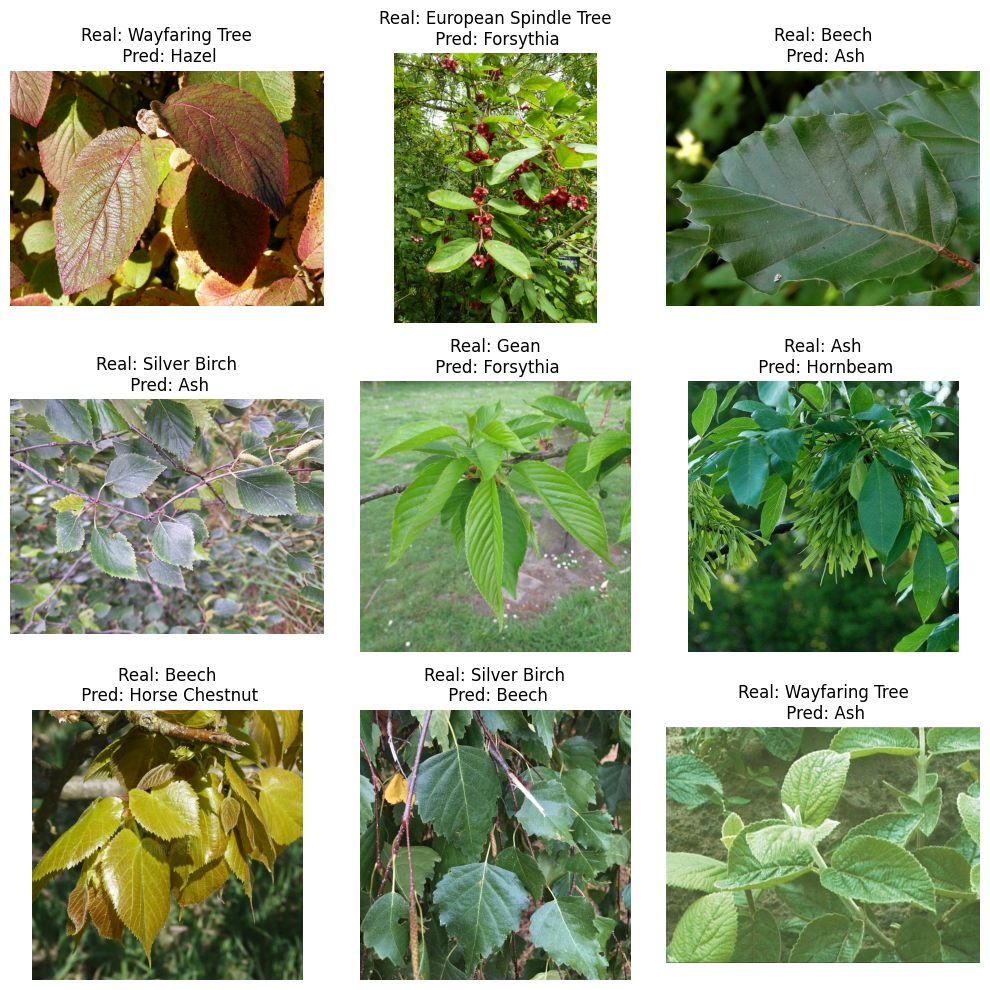

In [21]:
# Display some misclassified images
i = 0
limit = 9

plt.figure(figsize=(10, 10))  # Adjust as needed
for x in range(len(test_labels)):
    if pred[x] != test_labels[x]:
        ax = plt.subplot(3, 3, i + 1)
        plt.imshow(PIL.Image.open(test_df['path'][x]))
        plt.title("Real: " + label_encoder.classes_[test_labels[x]] + "\n Pred: " + label_encoder.classes_[pred[x]])
        plt.axis("off")
        i += 1
        if i >= limit:  
            break
plt.tight_layout()
plt.show()


**TODO**: display some misclassified images to be able to see what images are difficult for the model

## Use grad-cam to inspect how the model classify
Here we can see an heatmap of the regions that activates the model the most.

### For more information:
- tf-keras-vis documentation: https://keisen.github.io/tf-keras-vis-docs/
- Grad-cam paper: https://arxiv.org/pdf/1610.02391.pdf
- Grad-cam++ paper: https://arxiv.org/pdf/1710.11063.pdf

**NOTE**: maybe you will need to adapt some variable names based on your code above. For example, _model_ should be the model trained on all the training data. 

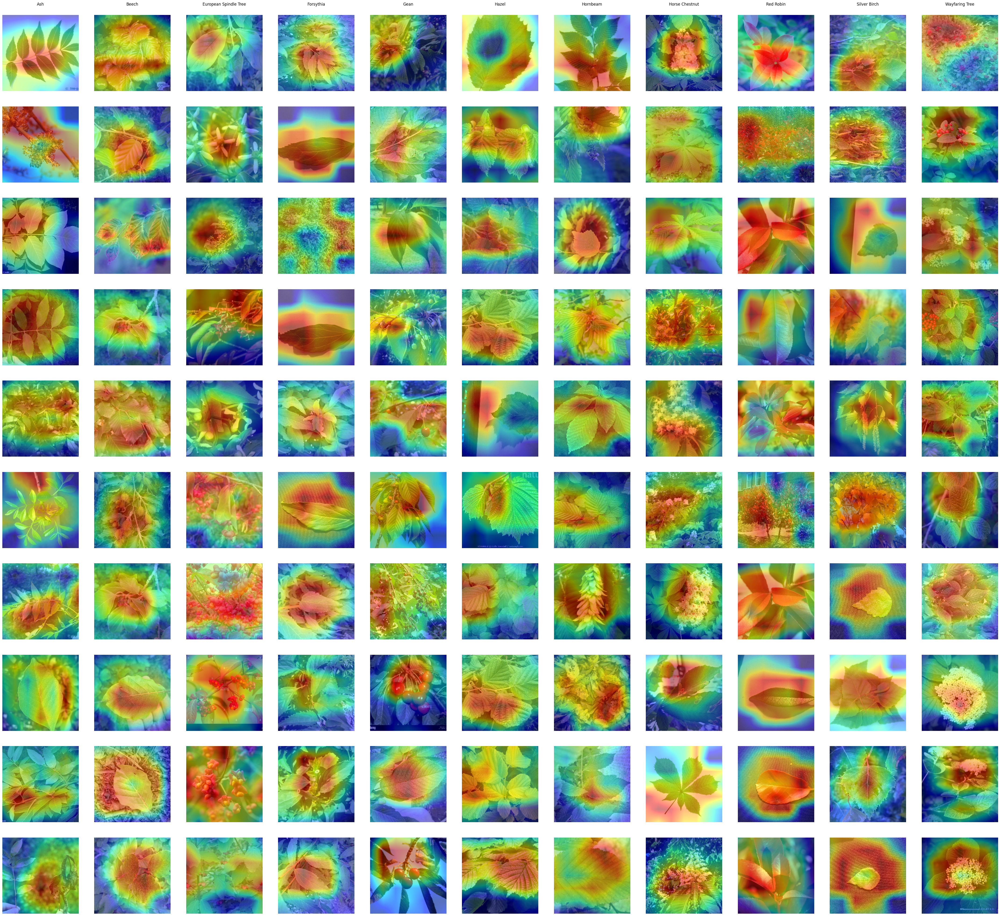

In [22]:
import numpy as np
from matplotlib import pyplot as plt
from matplotlib import cm
from tensorflow.keras.applications import MobileNetV2
from tf_keras_vis.gradcam_plus_plus import GradcamPlusPlus
from tf_keras_vis.utils.model_modifiers import ReplaceToLinear
from tf_keras_vis.utils.scores import CategoricalScore

# Create GradCAM++ object
gradcam = GradcamPlusPlus(
    model2,
    model_modifier=ReplaceToLinear(),
    clone=True,
)

nb_images_per_class = 10

fig, axs = plt.subplots(nb_images_per_class, len(LABEL_NAMES), figsize=(len(LABEL_NAMES) * 5, nb_images_per_class * 5))

for label_idx, label_name in enumerate(LABEL_NAMES):
    axs[0,label_idx].set_title(label_name, loc='center', y=1.1)
    
    i = 0
    for _, rowdata in train_df[train_df['label'] == label_name].sample(frac=1).head(nb_images_per_class).iterrows():
        img = open_image(rowdata.path)    
        pred = model(np.expand_dims(img, axis=0))

        # Generate cam with GradCAM++
        score = CategoricalScore(np.argmax(pred))
        cam = gradcam(score, img)
        heatmap = np.uint8(cm.jet(cam[0])[..., :3] * 255)

        axs[i,label_idx].imshow(img, vmin=0, vmax=1)
        axs[i,label_idx].imshow(heatmap, cmap='jet', alpha=0.5) # overlay
        axs[i,label_idx].axis("off")

        i += 1

### Grad-cam on misclassified images

**TODO**: now do the same than above, but with the misclassified images. You shouldn't change anything pertaining to grad-cam besides on which image and prediction you do it

1/1 [==============================] - 0s 22ms/step


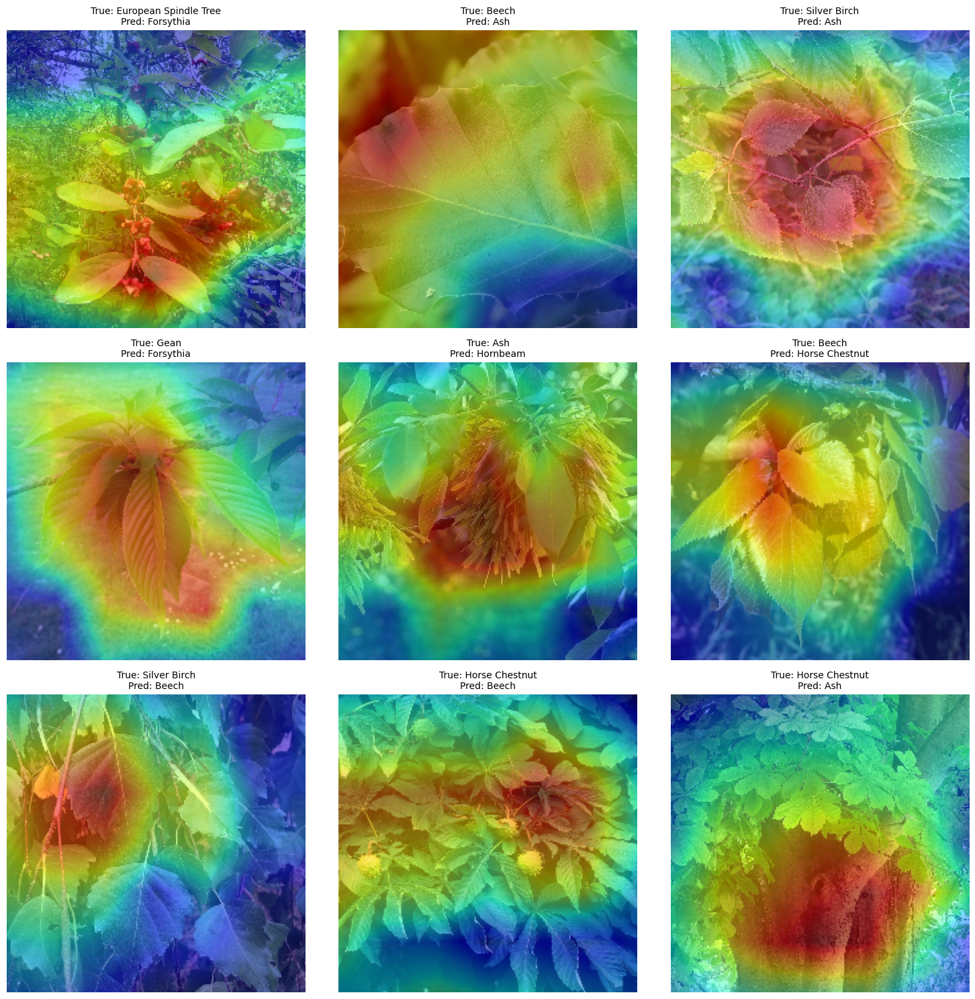

In [23]:
# Create GradCAM++ object (If not already created)
gradcam = GradcamPlusPlus(
  model2,
  model_modifier=ReplaceToLinear(),
  clone=True,
)

# Get the predicted classes
pred_classes = np.argmax(pred, axis=-1)

# Get the misclassified image paths
misclassified_image_paths = test_df[test_labels != pred_classes]['path']

# Set the number of rows and columns to ensure all misclassified images are displayed.
num_misclassified_images = len(misclassified_image_paths)
num_rows = num_misclassified_images // 3 + (1 if num_misclassified_images % 3 > 0 else 0)
num_cols = min(num_misclassified_images, 3)  # Maximum of 3 columns for better layout

# Get the indices of the misclassified images
misclassified_indices = test_df[test_labels != pred_classes].index
counting = 0
# Determine the appropriate number of rows based on how many misclassified images we actually plot
num_rows = -(-9 // 3)  # Ceiling division to always have enough rows for 9 images

plt.figure(figsize=(15, 5 * num_rows))
for i, (image_path, image_index) in enumerate(zip(misclassified_image_paths, misclassified_indices)):
    img = open_image(image_path)
    pred = model2.predict(np.expand_dims(img, axis=0))
    if np.argmax(pred) == test_labels[image_index]:
        continue

    # Generate cam with GradCAM++
    score = CategoricalScore(np.argmax(pred))
    cam = gradcam(score, img)
    heatmap = np.uint8(cm.jet(cam[0])[..., :3] * 255)

    # Dynamically adjust subplot index
    counting += 1
    ax = plt.subplot(num_rows, 3, counting)

    # Rest of the code for plotting (same as before)...
    ax.imshow(img, vmin=0, vmax=1)
    ax.imshow(heatmap, cmap='jet', alpha=0.5)  # Overlay
    predicted_class_index = np.argmax(pred[0])
    ax.set_title(
        f"True: {label_encoder.classes_[test_labels[image_index]]}\nPred: {label_encoder.classes_[predicted_class_index]}",
        fontsize=10
    )
    ax.axis("off")
    if counting >= 9:
        break


plt.tight_layout()
plt.show()